In [2]:
import time
import copy
import numpy as np
import pandas as pd
import seaborn as sn
from tqdm import tqdm
import matplotlib.pyplot as plt

import sklearn
from sklearn.manifold import TSNE
from sklearn.datasets import load_digits, fetch_openml

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Function

In [3]:
import torchvision as tv
import torchvision.transforms as transforms
from torch.autograd import Variable
from torchvision.utils import save_image

# Data Preprocessing

transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.1307,), (0.3081,))])
trainTransform  = tv.transforms.Compose([tv.transforms.ToTensor(), tv.transforms.Normalize((0.1307,), (0.3081,))])
trainset = tv.datasets.MNIST(root='./data',  train=True,download=True, transform=transform)
testset = tv.datasets.MNIST(root='./data',  train=False,download=True, transform=transform)

In [4]:
x = trainset[0][0].reshape(28,28)
x.shape

torch.Size([28, 28])

In [5]:
traindata = [i[0].reshape(-1) for i in trainset]
trainlabel = [i[1] for i in trainset]
testdata = [i[0].reshape(-1) for i in testset]
testlabel = [i[1] for i in testset]

X = traindata + testdata
y = trainlabel + testlabel

In [6]:
X = torch.vstack(X)
X.shape

torch.Size([70000, 784])

In [7]:
len(X), len(y)

(70000, 70000)

<Figure size 640x480 with 0 Axes>

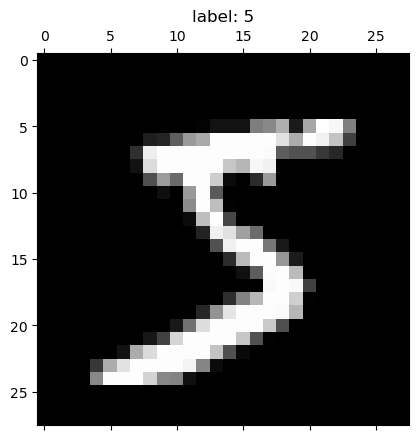

In [8]:
plt.gray()
plt.matshow(X[0].reshape(28,28))
plt.title("label: {}".format(y[0]))
plt.show()

# t-sne

In [8]:
t1 = time.time()
tsne = TSNE(n_components=2, random_state=2, learning_rate="auto", init="pca")
X_new2 = tsne.fit_transform(X)
t2 = time.time()
print("{}s".format(t2-t1))

D:\anaconda3\envs\graph\lib\site-packages\sklearn\manifold\_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


368.2244665622711s


<Figure size 1600x1600 with 0 Axes>

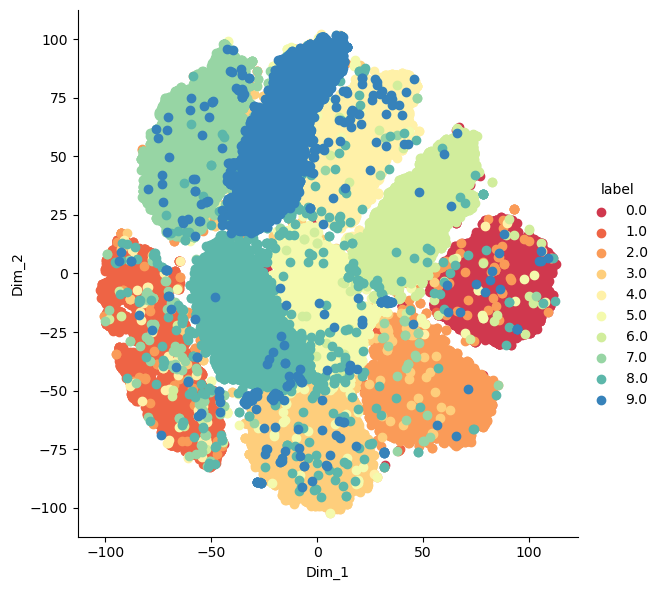

In [9]:
tsne_data = np.vstack((X_new2.T, y)).T
tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "label"))
tsne_df = tsne_df.sort_values("label")
plt.figure(figsize=(16,16))
sn.FacetGrid(tsne_df, hue="label", height=6, palette="Spectral").map(plt.scatter, "Dim_1", "Dim_2").add_legend()
plt.show()

In [10]:
tsne_data

array([[ 13.74165821,  -8.62976265,   5.        ],
       [ 76.31078339,   5.04337502,   0.        ],
       [ 42.00019836,  74.92726135,   4.        ],
       ...,
       [  7.764534  ,  35.72844696,   4.        ],
       [-14.74499321,   9.04502106,   5.        ],
       [ 33.70160294,  27.49389648,   6.        ]])

In [11]:
x = (tsne_data[:,0] - np.min(tsne_data[:,0])) / (np.max(tsne_data[:,0]) - np.min(tsne_data[:,0]))
x

array([0.54000233, 0.83101381, 0.67143392, ..., 0.51220249, 0.40750978,
       0.63283682])

In [12]:
y = (tsne_data[:,1] - np.min(tsne_data[:,1])) / (np.max(tsne_data[:,1]) - np.min(tsne_data[:,1]))
y

array([0.45737847, 0.5242549 , 0.86606263, ..., 0.67433806, 0.54382727,
       0.63406221])

In [13]:
I_hat = np.hstack([x.reshape(-1,1), y.reshape(-1,1), tsne_data[:, 2].reshape(-1,1)])
I_hat, I_hat.shape

(array([[0.54000233, 0.45737847, 5.        ],
        [0.83101381, 0.5242549 , 0.        ],
        [0.67143392, 0.86606263, 4.        ],
        ...,
        [0.51220249, 0.67433806, 4.        ],
        [0.40750978, 0.54382727, 5.        ],
        [0.63283682, 0.63406221, 6.        ]]),
 (70000, 3))

In [14]:
mat = np.zeros((1000,1000))
for i in range(len(I_hat)):
    xx = min(int(np.floor(I_hat[i,0]*1000)), 999)
    yy = min(int(np.floor(I_hat[i,1]*1000)), 999)
    mat[xx,yy] = I_hat[i, 2]
mat.shape

(1000, 1000)

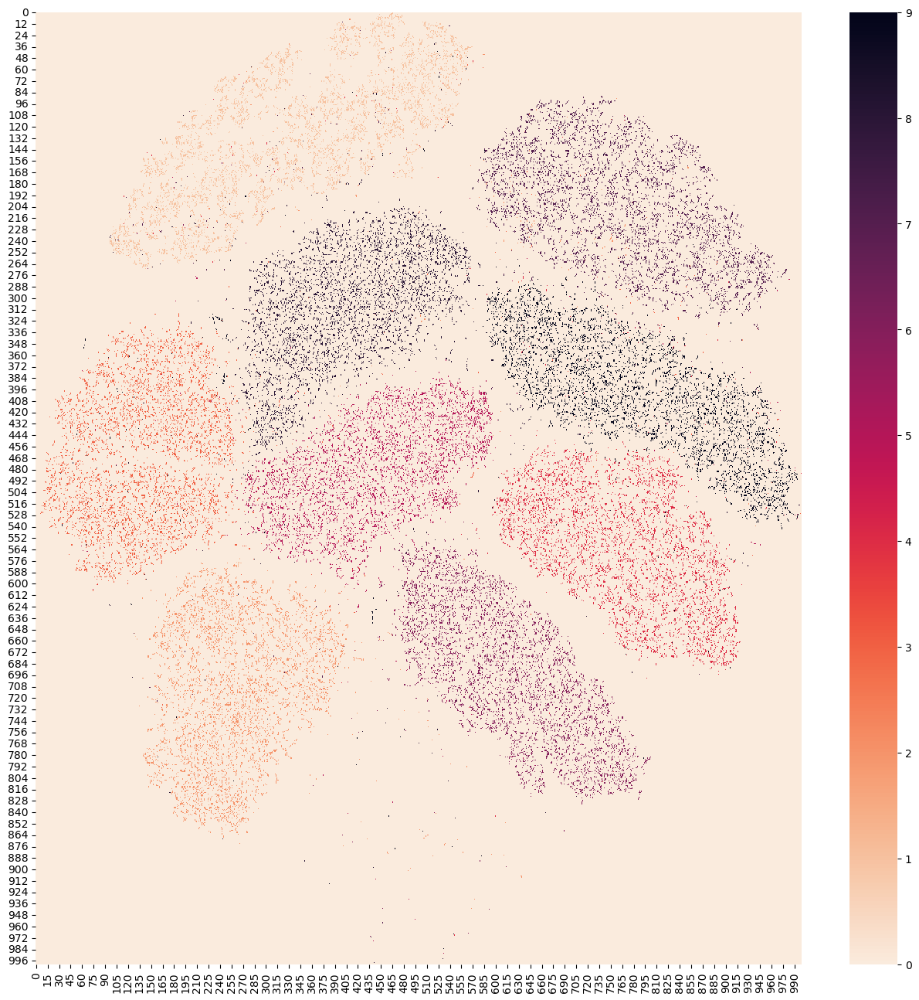

In [15]:
plt.figure(figsize=(16,16))
sn.heatmap(mat, cmap=sn.color_palette("rocket_r", as_cmap=True))
plt.show()

In [21]:
np.save("./tsne_data_reducted_normalised.npy", I_hat)

In [9]:
I_hat = np.load(open("./tsne_data_reducted_normalised.npy", "rb"))
I_hat.shape

(70000, 3)

In [18]:
np.save("./tsne_data_reducted.npy", tsne_data)

In [9]:
tsne_data = np.load(open("./tsne_data_reducted.npy", "rb"))
tsne_data.shape

(70000, 3)

# cluster boundary detection

In [10]:
I_hat

array([[0.54000233, 0.45737847, 5.        ],
       [0.83101381, 0.5242549 , 0.        ],
       [0.67143392, 0.86606263, 4.        ],
       ...,
       [0.51220249, 0.67433806, 4.        ],
       [0.40750978, 0.54382727, 5.        ],
       [0.63283682, 0.63406221, 6.        ]])

In [11]:
from sklearn.svm import SVC

model = SVC(decision_function_shape='ovo')

X = I_hat[:, :2]
y = I_hat[:, 2]

clf = model.fit(X, y)

In [40]:
pred = clf.predict(X)
pred.shape

(70000,)

In [41]:
from sklearn.metrics import accuracy_score

accuracy_score(pred, y)

0.9667428571428571

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


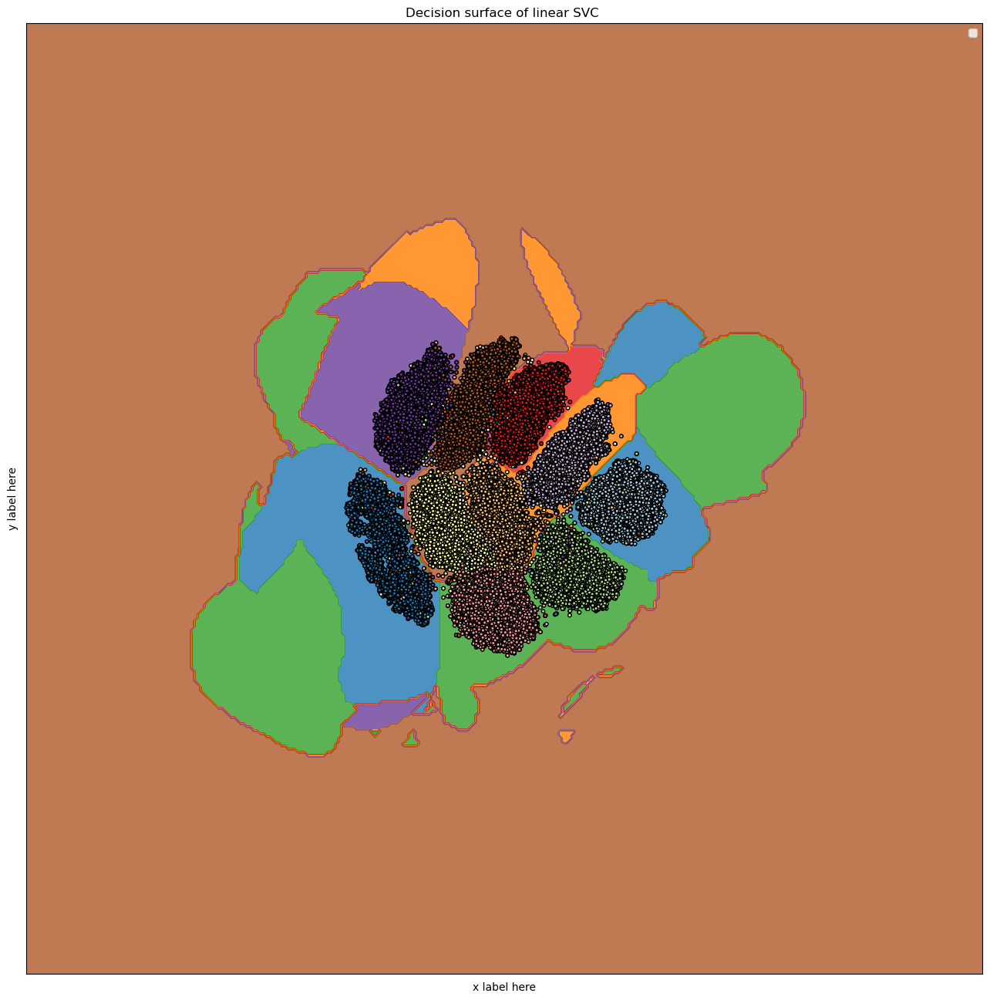

In [16]:
def make_meshgrid(x, y, h=.01):
    x_min, x_max = x.min() - 1, x.max() + 1
    y_min, y_max = y.min() - 1, y.max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

# model = svm.SVC(kernel='linear')
# clf = model.fit(X, y)

fig, ax = plt.subplots(figsize=(16,16))
# title for the plots
title = ('Decision surface of linear SVC ')
# Set-up grid for plotting.
X0, X1 = X[:, 0], X[:, 1]
xx, yy = make_meshgrid(X0, X1)

plot_contours(ax, clf, xx, yy, cmap=plt.cm.Paired, alpha=0.8)
ax.scatter(X0, X1, c=y, cmap=plt.cm.Paired, s=10, edgecolors='k', linewidths=1)
ax.set_ylabel('y label here')
ax.set_xlabel('x label here')
ax.set_xticks(())
ax.set_yticks(())
ax.set_title(title)
ax.legend()
plt.show()

In [24]:
Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
Z.shape

(90000,)

In [27]:
np.unique(Z)

array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9.])

In [29]:
# Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)
ax.contourf(xx, yy, Z)

<Figure size 1600x1600 with 0 Axes>

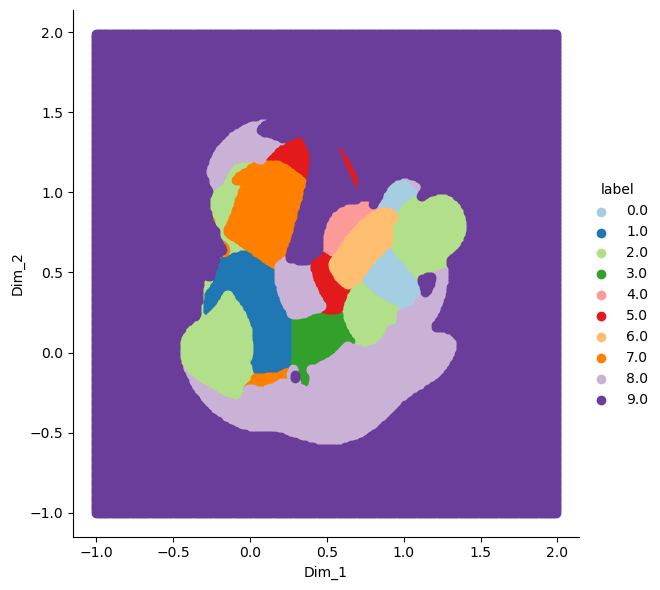

In [35]:
tsne_data = np.vstack((xx.ravel(), yy.ravel(), Z.ravel())).T
tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "label"))
tsne_df = tsne_df.sort_values("label")
plt.figure(figsize=(16,16))
sn.FacetGrid(tsne_df, hue="label", height=6, palette="Paired").map(plt.scatter, "Dim_1", "Dim_2").add_legend() # Spectral
plt.show()

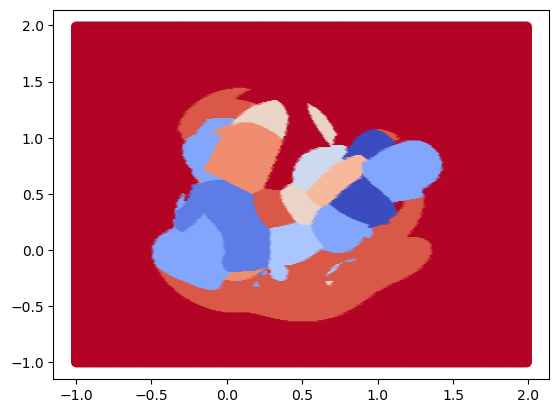

In [32]:
plt.scatter(xx, yy, c=Z, cmap=plt.cm.coolwarm)
# ax.set_ylabel('y label here')
# ax.set_xlabel('x label here')
# ax.set_xticks(())
# ax.set_yticks(())
# ax.set_title(title)
# ax.legend()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


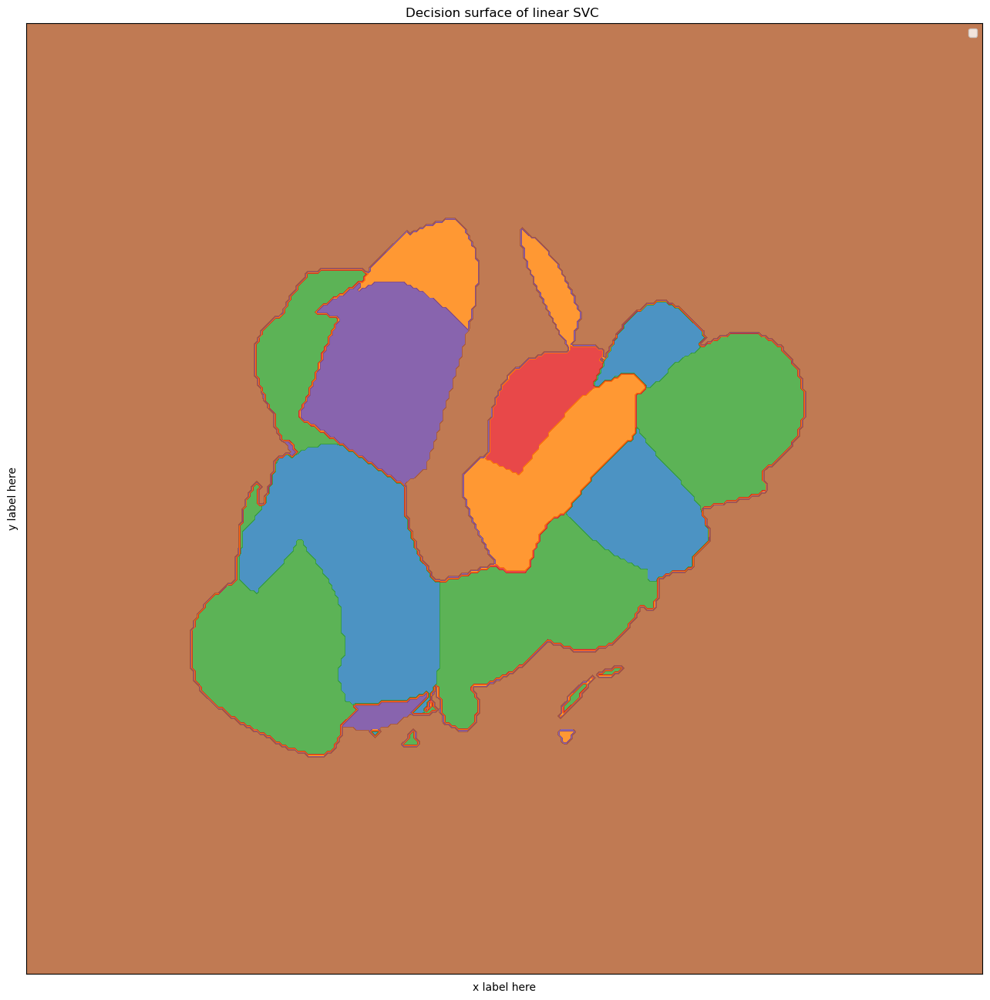

In [18]:
fig, ax = plt.subplots(figsize=(16,16))
# title for the plots
title = ('Decision surface of linear SVC ')
# Set-up grid for plotting.
X0, X1 = X[:, 0], X[:, 1]
xx, yy = make_meshgrid(X0, X1)

plot_contours(ax, clf, xx, yy, cmap=plt.cm.Paired, alpha=0.8)
# ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=1, edgecolors='k')
# ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, edgecolors='k')
ax.set_ylabel('y label here')
ax.set_xlabel('x label here')
ax.set_xticks(())
ax.set_yticks(())
ax.set_title(title)
ax.legend()
plt.show()

# gradient flow

### 1. self-define gradient
- different tensor shape

In [10]:
# from model import *

class VisualImitation(Function):
    
    @staticmethod
    def forward(ctx, input):
        x = torch.tensor(input, requires_grad=True)
        y = torch.zeros((1000,1000), requires_grad=True)
        y_update = y.clone()
        for i in range(len(x)):
            xx = min(int(torch.floor(x[i,0]*1000)), 999)
            yy = min(int(torch.floor(x[i,1]*1000)), 999)
            y_update[xx,yy] = x[i, 2]
        y = y_update
        
        ctx.save_for_backward(x, y) #ctx可以利用save_for_backward来保存tensors，在backward阶段可以进行获取
        return y
    
    @staticmethod
    def backward(ctx, grad_output):
        x, y = ctx.saved_tensors
        print("grad_output.shape: ", grad_output.shape)
        print("forward.shape: ", x.shape)        
        return torch.ones((x.shape[0], grad_output.shape[0])) @ grad_output @ torch.ones((grad_output.shape[1], x.shape[1]))

In [11]:
# Option 1: alias
# vi = VisualImitation.apply

# # Option 2: wrap in a function, to support default args and keyword args.
def vi(input):
    return VisualImitation.apply(input)

In [12]:
x = torch.tensor(I_hat, requires_grad=True)
out = vi(x)
print(x.shape, out.shape)

C:\Users\wanzh\AppData\Local\Temp\ipykernel_9020\1175900311.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  x = torch.tensor(input, requires_grad=True)


torch.Size([70000, 3]) torch.Size([1000, 1000])


In [13]:
gt = out*3
outn = torch.rand(out.shape)
out2 = out*2
out1 = out*1
criterion = nn.MSELoss()

In [14]:
lossn = criterion(outn, gt)
lossn.backward()
lossn, x.grad, x.grad.shape

grad_output.shape:  torch.Size([1000, 1000])
forward.shape:  torch.Size([70000, 3])


(tensor(14.3212, grad_fn=<MseLossBackward0>),
 tensor([[1.6689, 1.6689, 1.6689],
         [1.6689, 1.6689, 1.6689],
         [1.6689, 1.6689, 1.6689],
         ...,
         [1.6689, 1.6689, 1.6689],
         [1.6689, 1.6689, 1.6689],
         [1.6689, 1.6689, 1.6689]], dtype=torch.float64),
 torch.Size([70000, 3]))

In [28]:
loss2 = criterion(out2, gt)
loss2.backward()
loss2, x.grad, x.grad.shape

(tensor(1.6406, grad_fn=<MseLossBackward0>),
 tensor([[0.5184, 0.5184, 0.5184],
         [0.5184, 0.5184, 0.5184],
         [0.5184, 0.5184, 0.5184],
         ...,
         [0.5184, 0.5184, 0.5184],
         [0.5184, 0.5184, 0.5184],
         [0.5184, 0.5184, 0.5184]], dtype=torch.float64),
 torch.Size([70000, 3]))

In [33]:
loss1 = criterion(out1, gt)
loss1.backward()
loss1, x.grad, x.grad.shape

(tensor(6.5623, grad_fn=<MseLossBackward0>),
 tensor([[2.0738, 2.0738, 2.0738],
         [2.0738, 2.0738, 2.0738],
         [2.0738, 2.0738, 2.0738],
         ...,
         [2.0738, 2.0738, 2.0738],
         [2.0738, 2.0738, 2.0738],
         [2.0738, 2.0738, 2.0738]], dtype=torch.float64),
 torch.Size([70000, 3]))

#### demo VisualImitation

In [15]:
class myModel(nn.Module):

    def __init__(self, in_dim, cls):
        super(myModel,self).__init__()
        self.in_dim = in_dim
        self.cls = torch.tensor(cls).reshape(-1,1)
        
        # dimensionality reduction
        self.encoder = nn.Linear(self.in_dim, 2)
        
        # visual imitation module
        self.vis = VisualImitation.apply

        # human model
        # self.decoder = nn.Sequential(
        #     nn.Conv2d(1, 6, kernel_size=5),
        #     nn.ReLU(True),
        #     nn.Conv2d(6,16,kernel_size=5),
        #     nn.ReLU(True),
        #     nn.Sigmoid())

    def forward(self, x, z=None):
        """forward function

        :param x: data to be reduced in shape e.g., (70000, 784)
        :param z: reduced data in shape e.g., (70000, 2), defaults to None
        :return: human actions
        """
        
        # directly use z if provided
        if z==None:
            x = self.encoder(x)
            print(x.shape)
        else:
            x = z.clone()

        # add class info for vis
        x = torch.hstack([x, self.cls])
        print(x.shape)
        
        # visual imitation
        x = self.vis(x)
        print(x.shape)

        return x

In [16]:
x = X.clone().detach().requires_grad_(True)
x.shape

torch.Size([70000, 784])

In [17]:
z = torch.tensor(I_hat[:, :2]).clone().detach().requires_grad_(True)
z.shape

torch.Size([70000, 2])

In [18]:
cls = torch.tensor(I_hat[:, 2]).clone().detach().requires_grad_(True)
cls.shape

torch.Size([70000])

In [19]:
model = myModel(in_dim=784, cls=tsne_data[:, 2])

pred = model(x=x, z=z)

torch.Size([70000, 3])


C:\Users\wanzh\AppData\Local\Temp\ipykernel_9020\1175900311.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  x = torch.tensor(input, requires_grad=True)


torch.Size([1000, 1000])


In [20]:
pred.shape

torch.Size([1000, 1000])

In [21]:
label = torch.randn(pred.shape)
label.shape

torch.Size([1000, 1000])

In [22]:
criterion = nn.L1Loss()

loss = criterion(pred, label)
print(loss)
loss.backward()

tensor(1.0163, grad_fn=<L1LossBackward0>)
grad_output.shape:  torch.Size([1000, 1000])
forward.shape:  torch.Size([70000, 3])


In [23]:
import matplotlib

In [30]:
def draw_Ihat(I_hat):
#     mat = np.zeros((1000,1000))
#     for i in range(len(I_hat)):
#         xx = min(int(np.floor(I_hat[i,0]*1000)), 999)
#         yy = min(int(np.floor(I_hat[i,1]*1000)), 999)
#         mat[xx,yy] = I_hat[i, 2]
#     mat.shape
    plt.figure(figsize=(16,16), dpi=1500)
    sn.heatmap(I_hat, cmap=sn.color_palette("rocket_r", as_cmap=True))
    plt.show()

def draw_z(z, cls, s=25):
    tsne_data = np.hstack((z.numpy(), cls.reshape((-1,1)).numpy()))
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "label"))
    tsne_df = tsne_df.sort_values("label")
    plt.figure(dpi=1500)
    sn.FacetGrid(tsne_df, hue="label", height=6, palette="Spectral").map(plt.scatter, "Dim_1", "Dim_2", s=s).add_legend()
    matplotlib.rcParams["figure.dpi"] = 1500
    plt.show()

In [25]:
draw_Ihat(pred.detach().numpy())

In [31]:
draw_z(z=z.detach(), cls=cls.detach(), s=1)

<Figure size 9600x7200 with 0 Axes>

In [59]:
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, spectral_clustering

In [79]:
data = torch.hstack([z.detach(), cls.detach().reshape(-1,1)])

centroids = []

for i in range(10):

    ci = data[cls==i]
    x_mean = torch.mean(ci[:, 0]).item()
    y_mean = torch.mean(ci[:, 1]).item()

    centroids.append([x_mean, y_mean, i])

centroids

In [81]:
centroids = np.array(centroids)
centroids

array([[0.86330801, 0.47943365, 0.        ],
       [0.13356983, 0.33641138, 1.        ],
       [0.69893504, 0.27241439, 2.        ],
       [0.46257781, 0.15853893, 3.        ],
       [0.55934567, 0.76345953, 4.        ],
       [0.48271097, 0.44394952, 5.        ],
       [0.69387365, 0.61818182, 6.        ],
       [0.20988586, 0.75763363, 7.        ],
       [0.31777649, 0.4098102 , 8.        ],
       [0.40229289, 0.77261939, 9.        ]])

In [83]:
kmeans = KMeans(n_clusters=10, init='k-means++').fit(z.detach())

draw_z(z=z.detach(), cls=torch.tensor(kmeans.labels_), s=1)

<Figure size 9600x7200 with 0 Axes>

In [82]:
kmeans = KMeans(n_clusters=10, init=centroids[:, :2]).fit(z.detach())

draw_z(z=z.detach(), cls=torch.tensor(kmeans.labels_), s=1)

d:\anaconda3\envs\graph\lib\site-packages\sklearn\cluster\_kmeans.py:1307: RuntimeWarning: Explicit initial center position passed: performing only one init in KMeans instead of n_init=10.
  super()._check_params(X)


<Figure size 9600x7200 with 0 Axes>

In [55]:
dbs = DBSCAN(eps=10, min_samples=10, algorithm='ball_tree', metric='euclidean').fit(z.detach())

draw_z(z=z.detach(), cls=torch.tensor(dbs.labels_), s=1)

MemoryError: 

In [58]:
agg = AgglomerativeClustering(n_clusters=10).fit(z.detach())

draw_z(z=z.detach(), cls=torch.tensor(agg.labels_), s=1)

MemoryError: Unable to allocate 18.3 GiB for an array with shape (2449965000,) and data type float64

In [67]:
spec = spectral_clustering(n_clusters=10, affinity='rbf', assign_labels='discretize').fit(z.detach())

draw_z(z=z.detach(), cls=torch.tensor(spec.labels_), s=1)

AttributeError: 'str' object has no attribute 'ndim'

In [63]:
!conda list scikit-learn

# packages in environment at D:\anaconda3\envs\graph:
#
# Name                    Version                   Build  Channel
scikit-learn              1.1.3            py38hd77b12b_0    defaults


### 2. torch scatter
- not working
- can only impose on singel dimension

In [46]:
I_hat

array([[0.54000233, 0.45737847, 5.        ],
       [0.83101381, 0.5242549 , 0.        ],
       [0.67143392, 0.86606263, 4.        ],
       ...,
       [0.51220249, 0.67433806, 4.        ],
       [0.40750978, 0.54382727, 5.        ],
       [0.63283682, 0.63406221, 6.        ]])

In [ ]:
x = torch.tensor(I_hat, requires_grad=True)
y = torch.zeros((1000,1000), requires_grad=True)

y_update = y.clone()
for i in range(len(x)):
    xx = min(int(torch.floor(x[i,0]*1000)), 999)
    yy = min(int(torch.floor(x[i,1]*1000)), 999)
    y_update[xx,yy] = x[i, 2]

y = y_update
# y.mean().backward()
# print(x.grad)

In [47]:
x = torch.tensor(I_hat, requires_grad=True)
x

tensor([[0.5400, 0.4574, 5.0000],
        [0.8310, 0.5243, 0.0000],
        [0.6714, 0.8661, 4.0000],
        ...,
        [0.5122, 0.6743, 4.0000],
        [0.4075, 0.5438, 5.0000],
        [0.6328, 0.6341, 6.0000]], dtype=torch.float64, requires_grad=True)

In [48]:
cls = x[:, 2]
cls

tensor([5., 0., 4.,  ..., 4., 5., 6.], dtype=torch.float64,
       grad_fn=<SelectBackward0>)

In [49]:
pos = x[:, :2]
pos

tensor([[0.5400, 0.4574],
        [0.8310, 0.5243],
        [0.6714, 0.8661],
        ...,
        [0.5122, 0.6743],
        [0.4075, 0.5438],
        [0.6328, 0.6341]], dtype=torch.float64, grad_fn=<SliceBackward0>)

In [56]:
pos1 = torch.zeros(pos.shape, dtype=int)
pos1

tensor([[0, 0],
        [0, 0],
        [0, 0],
        ...,
        [0, 0],
        [0, 0],
        [0, 0]])

In [57]:
for i in range(len(pos)):
    pos1[i, 0] = xx = min(int(torch.floor(x[i,0]*1000)), 999)
    pos1[i, 1] = yy = min(int(torch.floor(x[i,1]*1000)), 999)
pos1

tensor([[540, 457],
        [831, 524],
        [671, 866],
        ...,
        [512, 674],
        [407, 543],
        [632, 634]])

In [72]:
mymap = torch.zeros((1000,1000)).float()
mymap = mymap.scatter_(dim=0, index=pos1, src=cls.float())

IndexError: Dimension out of range (expected to be in range of [-1, 0], but got 1)

# MSE to learn DR

In [7]:
X.shape

(70000, 784)

In [8]:
y.shape

(70000,)

In [9]:
X_new2.shape

(70000, 2)

In [10]:
label = copy.copy(X_new2)
label.shape

(70000, 2)

In [11]:
class MNISTDataset(torch.utils.data.Dataset):
    def __init__(self, data, digit, label):
        self.data = data
        self.digit = digit
        self.label = label
        
    def __getitem__(self, idx):
        return np.array(self.data.iloc[idx]).astype(float), int(self.digit[idx]), self.label[idx].astype(float)
    
    def __len__(self):
        return len(self.data)

In [37]:
dataset = MNISTDataset(data=X, digit=y, label=label)
dataloader = torch.utils.data.DataLoader(dataset=dataset, batch_size=1024, shuffle=True)

In [38]:
for img, cls, lbs in dataloader:
    break

In [39]:
img.shape, cls.shape, lbs.shape

(torch.Size([1024, 784]), torch.Size([1024]), torch.Size([1024, 2]))

<Figure size 1600x1600 with 0 Axes>

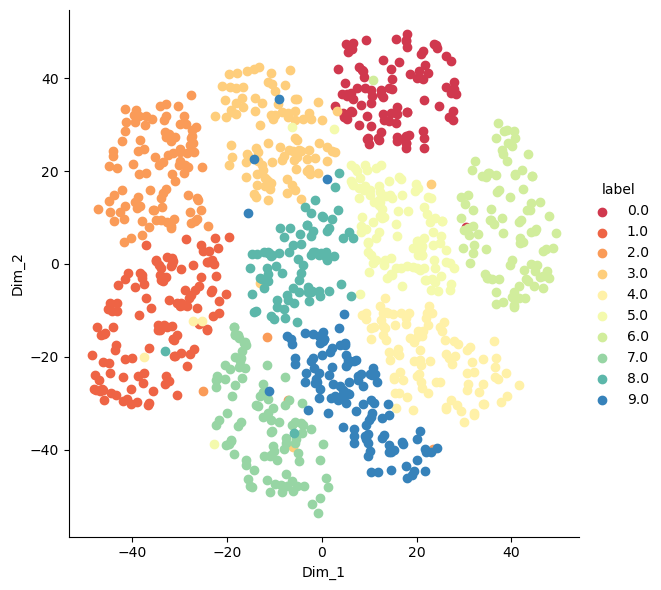

In [40]:
# plt.scatter(x=lbs[:,0], y=lbs[:,1])

data = np.vstack((lbs.T, cls)).T
df = pd.DataFrame(data=data, columns=("Dim_1", "Dim_2", "label"))
df = df.sort_values("label")
plt.figure(figsize=(16,16))
sn.FacetGrid(df, hue="label", height=6, palette="Spectral").map(plt.scatter, "Dim_1", "Dim_2").add_legend()
plt.show()

In [46]:
class Model(torch.nn.Module):

    def __init__(self):
        super(Model, self).__init__()

        self.linear1 = torch.nn.Linear(784, 100)
        self.bn1 = nn.BatchNorm1d(100)
        self.linear2 = torch.nn.Linear(100, 100)
        self.bn2 = nn.BatchNorm1d(100)
        self.linear3 = torch.nn.Linear(100, 2)
        self.softmax = torch.nn.Softmax()

    def forward(self, x):
        x = self.linear1(x)
        x = F.relu(x)
        x = self.bn1(x)
        
        x = self.linear2(x)
        x = F.relu(x)
        x = self.bn2(x)
        
        x = self.linear3(x)
        x = F.relu(x)
        x = F.softmax(x, dim=1)
        
        return x

In [48]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = Model().to(device)
out = model(torch.ones((16,784)).to(device))
out.shape

torch.Size([16, 2])

In [49]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=10, eta_min=1e-7, last_epoch=-1)

In [90]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 20

<IPython.core.display.Javascript object>

In [ ]:
epochs = 1000
train_loss = []

for i in range(epochs):
    batch_train_loss = []
    for img, cls, lbs in tqdm(dataloader):
        optimizer.zero_grad()
        
        out = model(img.to(device).float())
        
        loss = criterion(out, lbs.to(device).float())
        loss.backward()
        
        torch.nn.utils.clip_grad_norm_(model.parameters(), 0.1)
        
        optimizer.step()
        batch_train_loss.append(loss.item())
        
    train_loss.append(np.mean(batch_train_loss))
    print("Epoch: {}\nTrain Loss: {}".format(i, train_loss[-1]))

# autoencoder

In [2]:
# -*- coding: utf-8 -*-
"""
Created on Thu Aug 15 11:21:22 2019

@author: suchismitasa
"""

import torch
import torchvision as tv
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torchvision.utils import save_image

# Data Preprocessing

transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.1307,), (0.3081,))])
trainTransform  = tv.transforms.Compose([tv.transforms.ToTensor(), tv.transforms.Normalize((0.1307,), (0.3081,))])
trainset = tv.datasets.MNIST(root='./data',  train=True,download=True, transform=transform)
dataloader = torch.utils.data.DataLoader(trainset, batch_size=32, shuffle=False, num_workers=4)
testset = tv.datasets.MNIST(root='./data', train=False, download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=4, shuffle=False, num_workers=2)

# Defining Model

class Autoencoder(nn.Module):

    def __init__(self):
        super(Autoencoder,self).__init__()
        
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 6, kernel_size=5),
            nn.ReLU(True),
            nn.Conv2d(6,16,kernel_size=5),
            nn.ReLU(True))

        self.decoder = nn.Sequential(             
            nn.ConvTranspose2d(16,6,kernel_size=5),
            nn.ReLU(True),
            nn.ConvTranspose2d(6,1,kernel_size=5),
            nn.ReLU(True),
            nn.Sigmoid())

    def forward(self,x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x


# Defining Parameters

num_epochs = 5
batch_size = 128
model = Autoencoder().cpu()
distance = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(),weight_decay=1e-5)

for epoch in range(num_epochs):
    for data in dataloader:
        img, _ = data
        img = Variable(img).cpu()
        # ===================forward=====================
        output = model(img)
        loss = distance(output, img)
        # ===================backward====================
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    # ===================log========================
    print('epoch [{}/{}], loss:{:.4f}'.format(epoch+1, num_epochs, loss.item()))

epoch [1/5], loss:0.9752
epoch [2/5], loss:0.9750
epoch [3/5], loss:0.9749
epoch [4/5], loss:0.9749
epoch [5/5], loss:0.9749


In [ ]:
np.ones((99, 2))

normalize 0~1000

(20, 30)

X_max = 100
Y_max = 200

(200, 150)

<AxesSubplot:>

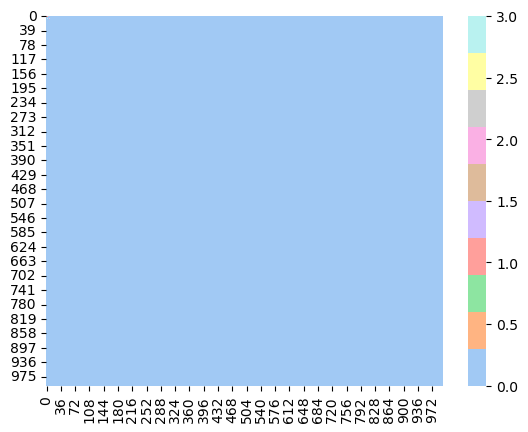

In [19]:
X = np.zeros((1000,1000))

for i in range(3):
    for j in range(3):
        X[i,j]=1
        X[i+6, j+6]=2
    X[i+5, j]=3

sn.heatmap(X, cmap=sn.color_palette("pastel", as_cmap=True))

In [3]:
X_new2[None, :].shape, X_new2[:, None].shape

NameError: name 'X_new2' is not defined

In [ ]:
Xn = X_new2[:10,:]

(Xn[None, :]-Xn[:, None]).shape

In [ ]:
((Xn[None, :]-Xn[:, None])**2).shape

<AxesSubplot:>

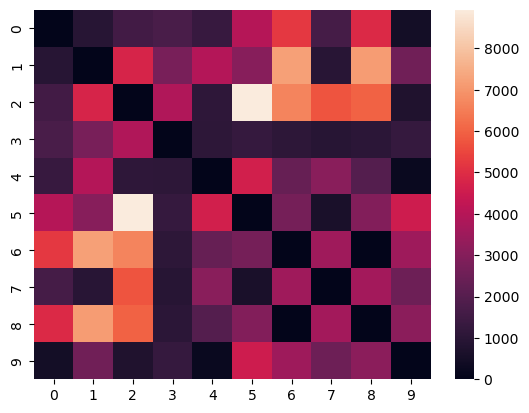

In [69]:
sn.heatmap(np.sum((Xn[None, :]-Xn[:, None])**2, 2))